# Only For Google Colab

In [1]:
# Put the cropped images in a zip file and upload to colab
!unzip cropped.zip

In [2]:
%pip install xmltodict

# For Anywhere

In [2]:
import cv2
import matplotlib.image as img
import matplotlib.pyplot as plt
import numpy as np
import os
import random
import tensorflow as tf
import xmltodict

from tensorflow import keras

tf.config.list_physical_devices()

[PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'),
 PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

# Look at images and their keypoints

All images of shells should be cropped and in a folder called `cropped_images` and keypoint annotations should be in a folder called `keypoint_annotations`.

In [3]:
img_dir = os.path.join('..', 'cropped_images')
# img_dir = os.path.join('..', 'c')
xml_path = os.path.join('..', 'keypoint_annotations.xml')

In [36]:
# Get shell keypoints.
def get_keypoints(xml_path, image_name):
    """
    Parses keypoints from xml for a specific image.

    Arguments:
        xml_path: path to the xml created by CVAT.
        image_name: name of the image annotated by CVAT.

    Returns:
        tuple: ([corners that make the scutes perimeter], [the centers of the three scutes]).
    """

    with open(xml_path, 'r') as f:
        xml_dict = xmltodict.parse(f.read())
        centers = []
        corners = []
        for img_annotation in xml_dict['annotations']['image']:
            if image_name == img_annotation['@name']:
                if len(img_annotation['points']) > 1:
                    for label in img_annotation['points']:
                        if label['@label'] == 'centers':
                            for point in label['@points'].split(";"):
                                centers.append(tuple(round(float(coord ))for coord in point.split(',')))
                        if label['@label'] == 'corners':
                            for point in label['@points'].split(";"):
                                corners.append(tuple(round(float(coord ))for coord in point.split(',')))

    return corners, centers

In [37]:
# Get image names and shell keypoints.
image_names = []
keypoints = []
for file in os.listdir(img_dir):
    if os.path.splitext(file)[1] == '.jpg':
        image_names.append(file)
        keypoints.append(get_keypoints(xml_path, file))

print(f'length of images: {len(image_names)}')
print(f'length of keypoints: {len(keypoints)}')

length of images: 81
length of keypoints: 81


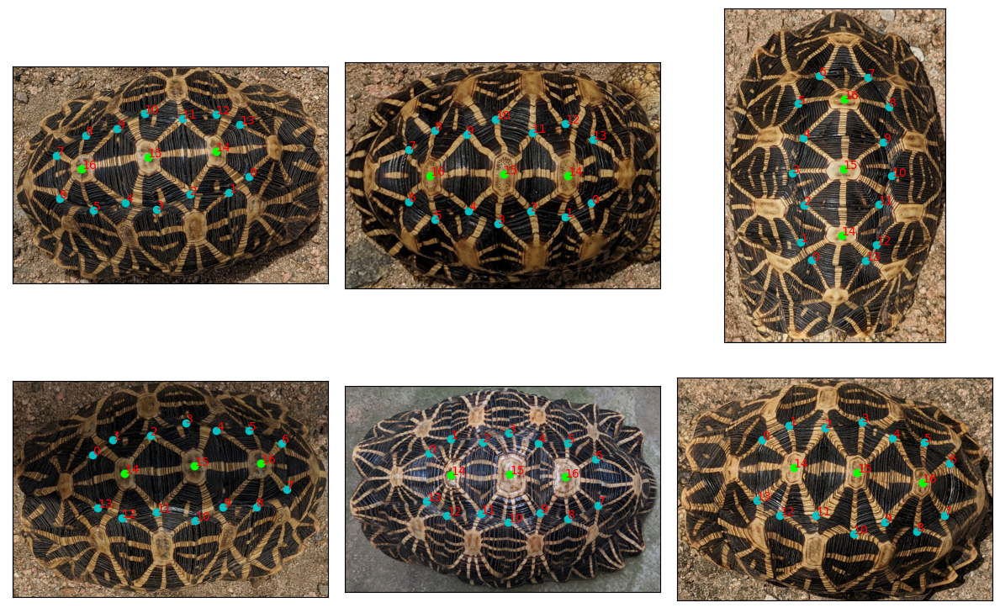

In [38]:
# Plot a sample of images and their keypoints.
fig = plt.figure(figsize=(12, 8))
axes = fig.subplots(2, 3)
flatten_axes = axes.flatten()
random_image_idx = random.sample(range(len(image_names)), k=len(flatten_axes))

for e, i in enumerate(random_image_idx):

    # Read and plot image.
    image = img.imread(os.path.join(img_dir, image_names[i]))
    flatten_axes[e].imshow(image)
    flatten_axes[e].get_xaxis().set_visible(False)
    flatten_axes[e].get_yaxis().set_visible(False)

    # Plot keypoints.
    points = np.concatenate(keypoints[i])
    x, y  = points[:, 0], points[:, 1]
    flatten_axes[e].scatter(x[:-3], y[:-3], c='c')
    flatten_axes[e].scatter(x[-3:], y[-3:], c='lime')

    # Numerate the points.
    for point_idx, (x_i, y_i) in enumerate(zip(x, y)):
        flatten_axes[e].text(x_i, y_i, point_idx, c='r')

plt.tight_layout()
plt.show()

# Create TFDataset

In [86]:
flat_keypoints = [list(np.concatenate([corners, centers]).flatten()) for corners, centers in keypoints]

In [87]:
num_samples = 27
num_tfrecords = -1* (-len(image_names) // num_samples)

tfdatasets_dir = ('tfdatasets')
if not os.path.exists(tfdatasets_dir):
    os.makedirs(tfdatasets_dir)

In [88]:
def create_example(image, path, keypoints):
    feature = {
        "image": tf.train.Feature(bytes_list=tf.train.BytesList(value=[tf.io.encode_jpeg(image).numpy()])),
        "path": tf.train.Feature(bytes_list=tf.train.BytesList(value=[path.encode()])),
        "keypoints": tf.train.Feature(int64_list=tf.train.Int64List(value=keypoints))
    }
    return tf.train.Example(features=tf.train.Features(feature=feature))

In [89]:
for tfrec_num in range(num_tfrecords):
    samples = image_names[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]
    targets = flat_keypoints[tfrec_num*num_samples : num_samples+num_samples*tfrec_num]

    with tf.io.TFRecordWriter(
        tfdatasets_dir + "/file_%.2i-%i.tfrec" % (tfrec_num, len(samples))
    ) as writer:
        for sample, target in zip(samples, targets):
            image_path = os.path.join(img_dir, sample)
            image = tf.io.decode_jpeg(tf.io.read_file(image_path))
            example = create_example(image, image_path, target)
            writer.write(example.SerializeToString())

In [386]:
def parse_tfrecord_fn(example):
    feature_description = {
        "image": tf.io.FixedLenFeature([], tf.string),
        "path": tf.io.FixedLenFeature([], tf.string),
        "keypoints": tf.io.VarLenFeature(tf.int64),

    }
    example = tf.io.parse_single_example(example, feature_description)
    example["image"] = tf.io.decode_jpeg(example["image"], channels=3)
    example["keypoints"] = tf.sparse.to_dense(example["keypoints"])
    return example["image"], example["keypoints"]


In [379]:
records = [os.path.join(tfdatasets_dir, file) for file in os.listdir(tfdatasets_dir)]
records

['tfdatasets/file_02-27.tfrec',
 'tfdatasets/file_00-27.tfrec',
 'tfdatasets/file_01-27.tfrec']

In [266]:
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.padded_batch(2)

In [267]:
batches = iter(train_dataset)

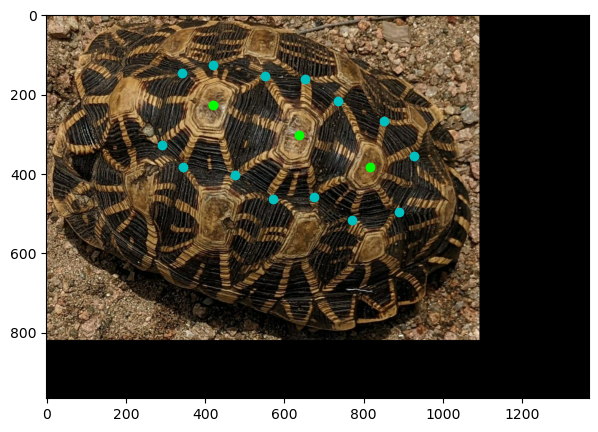

In [268]:
batch = next(batches)
image = batch[0][0]
points = batch[1][0]

plt.figure(figsize=(7, 7))
plt.imshow(image)


x = []
y = []
for coord in zip(points[::2], points[1::2]):
    x.append(coord[0])
    y.append(coord[1])
    
plt.scatter(x[:-3], y[:-3], c='c')
plt.scatter(x[-3:], y[-3:], c='lime')

plt.show()

# Resize images

We resize images to be a square.

In [617]:
def resize_images_keypoints(image, keypoints, size=256):
        # image = sample[0]
        # # keypoints = sample[1]

        resized_img = tf.image.resize(image, (size, size), method='nearest')
        x, y = tf.cast(keypoints[::2], dtype=tf.float64), tf.cast(keypoints[1::2], dtype=tf.float64)
        resized_trgts = [1, 2, 3, 4]
        image_shape = tf.cast(tf.shape(image)[:2], dtype=tf.int32)
        resized_x = tf.cast(tf.multiply(x, tf.divide(size, image_shape[1])), dtype=tf.int32)
        resized_y =  tf.cast(tf.multiply(y, tf.divide(size, image_shape[0])), dtype=tf.int32)
        
        # resized_trgts = tf.squeeze(tf.reshape(tf.stack((resized_x, resized_y), axis=-1), shape=(-1, 34)))

        # resized_trgts = tf.stack((resized_x, resized_y))
        resized_trgts = tf.reshape(tf.stack((resized_x, resized_y), axis=-1), shape=(-1, 34))[0]
        return resized_img, resized_trgts

In [1128]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.padded_batch(16)

In [1129]:
batches = iter(train_dataset)

In [1130]:
batch = next(batches)

In [1139]:
def plot_images_keypoints(images, keypoints, rows=3, cols=5):
    fig = plt.figure(figsize=(3*cols, 3*rows))
    axes = fig.subplots(rows, cols)
    flatten_axes = axes.flatten()

    for i, image in enumerate(images):
        
        if i >= rows*cols:
            break
        
        
        # Read image.
        flatten_axes[i].imshow(image)

        # Plot keypoints.
        x = []
        y = []
        for coord in zip(keypoints[i, ::2], keypoints[i, 1::2]):
            x.append(coord[0])
            y.append(coord[1])
            
        flatten_axes[i].scatter(x[:-3], y[:-3], c='c')
        flatten_axes[i].scatter(x[-3:], y[-3:], c='lime')
        flatten_axes[i].get_xaxis().set_visible(False)
        flatten_axes[i].get_yaxis().set_visible(False)

    plt.show()

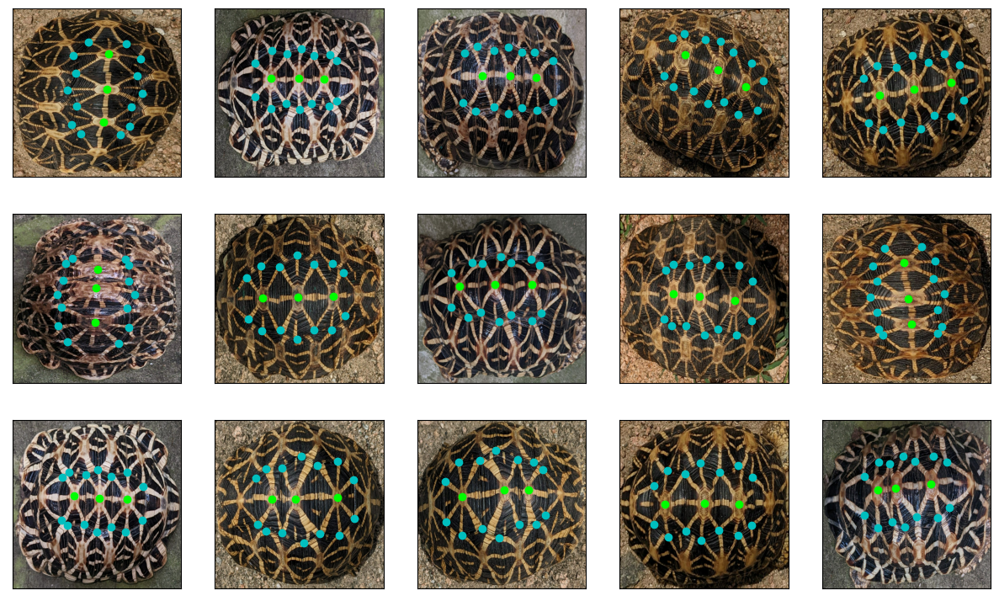

In [1140]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

# Augmentation

In [10]:
train_images = resized_imgs
train_keypoints = resized_trgts

## Flip

In [11]:
def flip_images(images, keypoints):
    flipped_images = []
    flipped_keypoints = []
    for image, keypoint in zip(images, keypoints):
        flipped_images.append(cv2.flip(image, 0))
        keypoint = keypoint.copy()
        keypoint[1::2] = keypoint[1::2] + ((image.shape[0]/2)-keypoint[1::2])*2
        flipped_keypoints.append(keypoint)

    return np.array(flipped_images), np.array(flipped_keypoints)

In [698]:
def flip_images_keypoints(image, keypoints):
    if tf.random.uniform(()) > 0.5:
        image = tf.image.flip_left_right(image)
        image_shape = tf.shape(image)[:2]
        keypoints = tf.reshape(tf.stack([image_shape[1] - keypoints[::2], keypoints[1::2]], axis=-1), shape=(-1,34))[0]
    return image, keypoints

In [699]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, 640))
train_dataset = train_dataset.map(flip_images_keypoints)
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.batch(16)

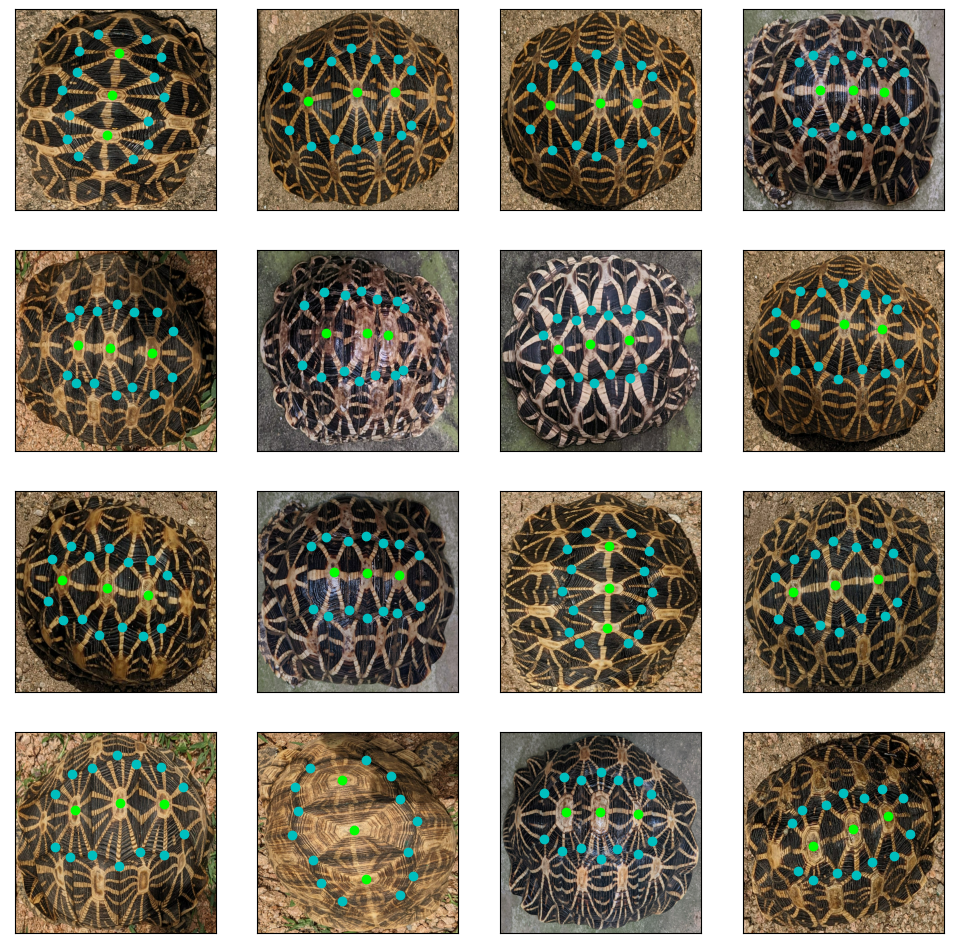

In [700]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

In [675]:
batch[1][0]

<tf.Tensor: shape=(34,), dtype=int32, numpy=
array([168, 159, 210, 105, 271, 110, 343,  88, 396, 121, 466, 145, 518,
       209, 521, 341, 465, 384, 392, 377, 337, 406, 273, 375, 204, 381,
       168, 347, 209, 228, 327, 225, 455, 250], dtype=int32)>

In [676]:
batch[1][0][::2]

<tf.Tensor: shape=(17,), dtype=int32, numpy=
array([168, 210, 271, 343, 396, 466, 518, 521, 465, 392, 337, 273, 204,
       168, 209, 327, 455], dtype=int32)>

In [677]:
batch[1][0][1::2]

<tf.Tensor: shape=(17,), dtype=int32, numpy=
array([159, 105, 110,  88, 121, 145, 209, 341, 384, 377, 406, 375, 381,
       347, 228, 225, 250], dtype=int32)>

In [659]:
tf.reshape(tf.stack((batch[1][0][::2], batch[1][0][1::2]), axis=-1), shape=34)

<tf.Tensor: shape=(34,), dtype=int32, numpy=
array([200, 466, 165, 413, 172, 336, 150, 258, 198, 199, 205, 134, 264,
        80, 416,  94, 464, 152, 444, 216, 476, 281, 425, 355, 423, 428,
       377, 476, 292, 402, 309, 272, 332, 140], dtype=int32)>

(81, 256, 256, 3)
(81, 34)


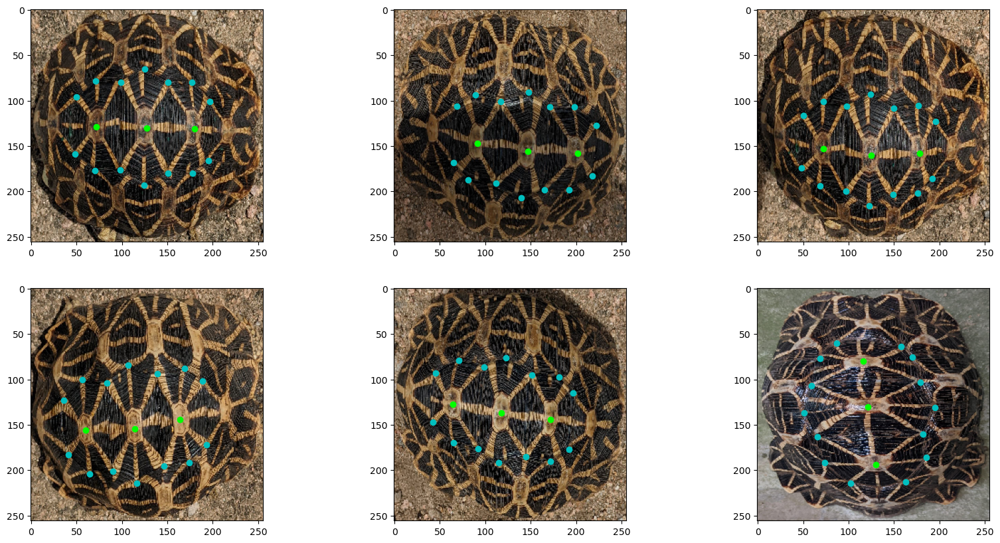

In [12]:
flipped_images, flipped_keypoints = flip_images(train_images, train_keypoints)
print(flipped_images.shape)
print(flipped_keypoints.shape)
plot_images_keypoints(flipped_images, flipped_keypoints)

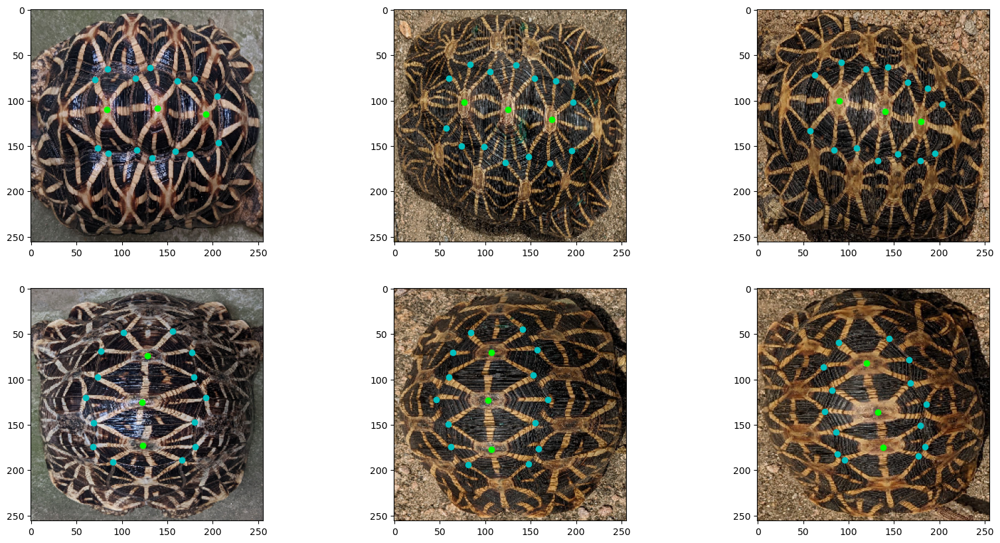

In [13]:
plot_images_keypoints(train_images, train_keypoints)

In [14]:
train_images = np.concatenate((train_images, flipped_images))
train_keypoints = np.concatenate((train_keypoints, flipped_keypoints))

In [15]:
print(train_images.shape)
print(train_keypoints.shape)

(162, 256, 256, 3)
(162, 34)


## Rotate

In [779]:
for i in range(10):
    angle = tf.random.uniform([], maxval= 359)
    print(angle)
angle.numpy()

tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)
tf.Tensor(111.93368, shape=(), dtype=float32)


111.93368

In [17]:
# def rotate_images_keypoints(images, keypoints, angles=[12]):
#     rotated_images = []
#     rotated_keypoints = []
#     for angle in angles:
#         for image, keypoint in zip(images, keypoints):
#             width, height = image.shape[:2]
#             M = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
#             rotated_images.append(cv2.warpAffine(image, M, (width, height), flags=cv2.INTER_CUBIC))
#             angle_cos, angle_sin = M[0, 0], M[1, 0]

#             rotated_keypoint = []
#             for i in range(0, len(keypoint), 2):
#                 x, y = keypoint[i] - width/2, keypoint[i+1] - height/2
#                 rot_x = (x*angle_cos) - (y*angle_sin)
#                 rot_y = (y*angle_cos) + (x*angle_sin)
#                 rotated_keypoint += [rot_x+width/2, rot_y+height/2]

#             rotated_keypoints.append(rotated_keypoint)


#     return np.array(rotated_images), np.array(rotated_keypoints)

In [719]:
import tensorflow_addons as tfa

In [1079]:
M = cv2.getRotationMatrix2D((128, 128), 15, 1)
print(M)
angle_cos, angle_sin = M[0, 0], M[1, 0]

angle_cos, angle_sin

[[  0.96592583   0.25881905 -28.76734354]
 [ -0.25881905   0.96592583  37.49033201]]


(0.9659258262890683, -0.25881904510252074)

In [879]:
angle = np.random.uniform(low=0, high=359)
angle

142.79052519246883

In [ ]:
#             width, height = image.shape[:2]
#             M = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
#             rotated_images.append(cv2.warpAffine(image, M, (width, height), flags=cv2.INTER_CUBIC))
#             angle_cos, angle_sin = M[0, 0], M[1, 0]

#             rotated_keypoint = []
#             for i in range(0, len(keypoint), 2):
#                 x, y = keypoint[i] - width/2, keypoint[i+1] - height/2
#                 rot_x = (x*angle_cos) - (y*angle_sin)
#                 rot_y = (y*angle_cos) + (x*angle_sin)
#                 rotated_keypoint += [rot_x+width/2, rot_y+height/2]

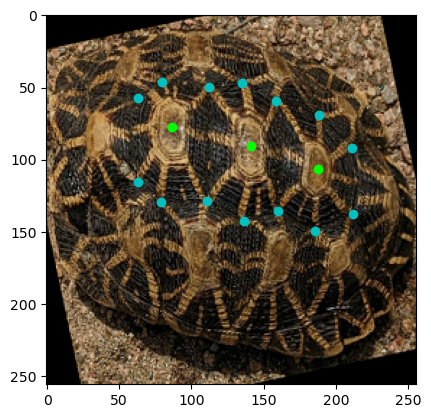

In [1087]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
# train_dataset = train_dataset.map(rotate_images_keypoints)
# train_dataset = train_dataset.map(flip_images_keypoints)
# train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.batch(16)

batches = iter(train_dataset)
batch = next(batches)
image = batch[0][0].numpy()
points = batch[1][0].numpy()

angles = [12]
rotated_images = []
rotated_keypoints = []

width, height = image.shape[:2]
M = cv2.getRotationMatrix2D((width/2, height/2), angle, 1)
rotated_image = cv2.warpAffine(image, M, (width, height), flags=cv2.INTER_CUBIC)
angle_cos, angle_sin = M[0, 0], M[1, 0]

rotated_keypoint = []
for i in range(0, len(points), 2):
    x, y = points[i] - width/2, points[i+1] - height/2
    rot_x = (x*angle_cos) - (y*angle_sin)
    rot_y = (y*angle_cos) + (x*angle_sin)
    rotated_keypoint += [rot_x+width/2, rot_y+height/2]

rotated_keypoint

# Plot keypoints.
x = []
y = []
for coord in zip(rotated_keypoint[::2], rotated_keypoint[1::2]):
    x.append(coord[0])
    y.append(coord[1])
    
plt.scatter(x[:-3], y[:-3], c='c')
plt.scatter(x[-3:], y[-3:], c='lime')

plt.imshow(rotated_image)
plt.show()

In [1107]:
def rotate_images_keypoints(images, keypoints):
    keypoints = tf.cast(keypoints, tf.float32)

    angle = tf.random.uniform((), maxval= 359)
    radians = angle * (np.pi/180)
    image = tfa.image.rotate(images, radians)
    image_shape = tf.shape(image)[:2]

    radians = angle * (np.pi/180)
    angle_cos, angle_sin = tf.math.cos(radians), -tf.math.sin(radians)
    half_width = tf.cast(image_shape[1]/2, dtype=tf.float32)
    half_height = tf.cast(image_shape[0]/2, dtype=tf.float32)

    x = keypoints[::2] - half_width
    y = keypoints[1::2] - half_height

    rot_x = (x*angle_cos) - (y*angle_sin)
    rot_y = (y*angle_cos) + (x*angle_sin)
    rot_x = rot_x+half_width
    rot_y = rot_y+half_height
    
    keypoints = tf.reshape(tf.stack([rot_x, rot_y], axis=-1), shape=(-1,34))[0]
    
    return image, keypoints

In [1120]:
IMAGE_SIZE = 256
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(rotate_images_keypoints)
train_dataset = train_dataset.shuffle(64)
train_dataset = train_dataset.batch(16)

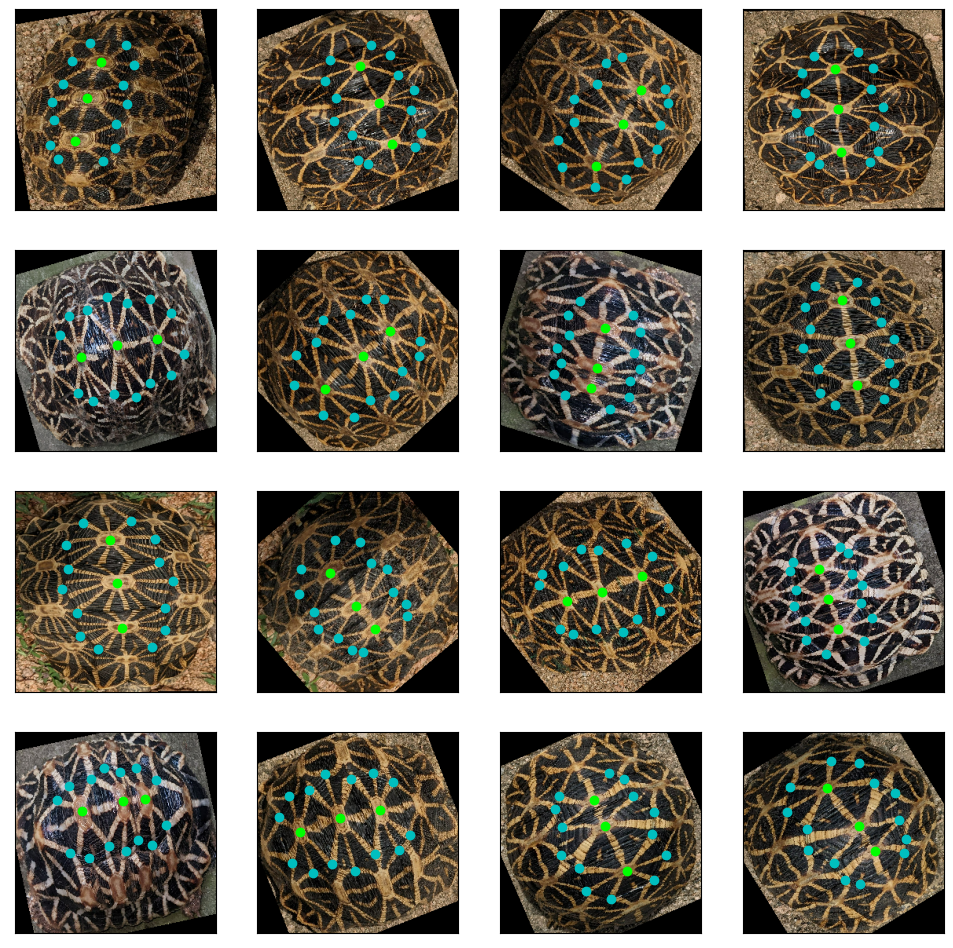

In [1121]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

In [1125]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE))
train_dataset = train_dataset.map(flip_images_keypoints)
train_dataset = train_dataset.map(rotate_images_keypoints)
train_dataset = train_dataset.shuffle(8*BATCH_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

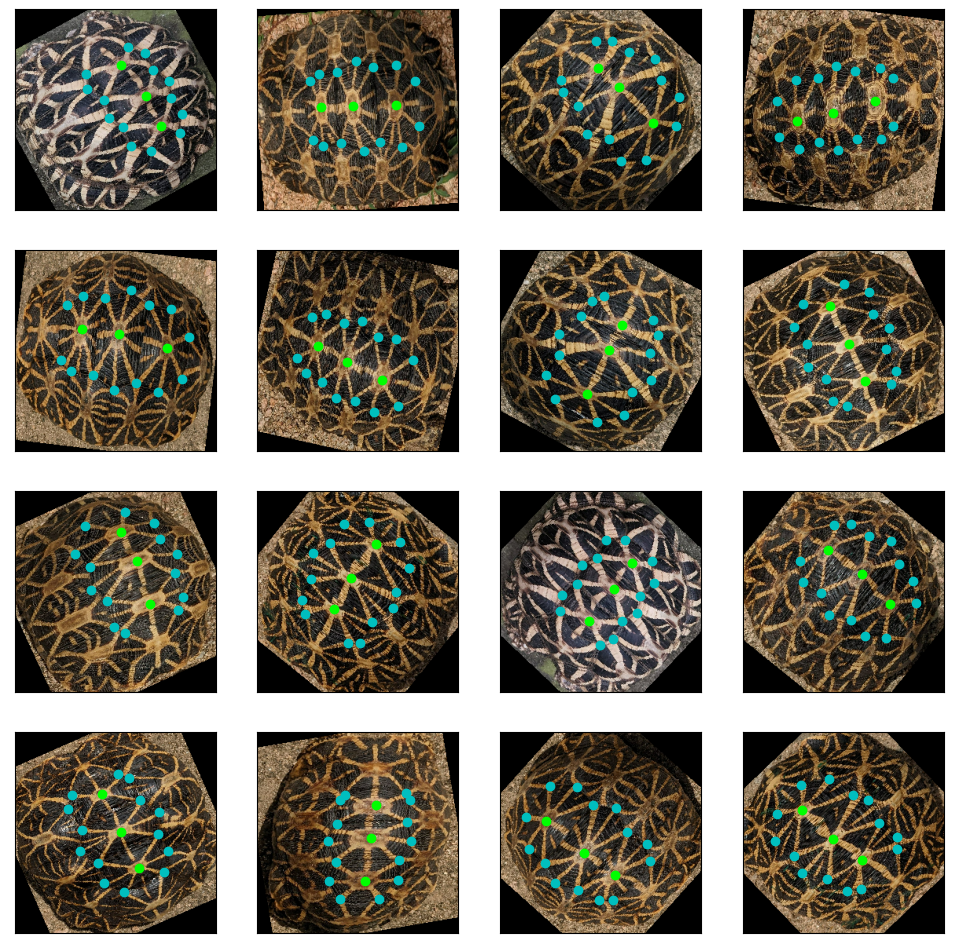

In [1124]:
batches = iter(train_dataset)
batch = next(batches)
images = batch[0]
points = batch[1]

plot_images_keypoints(images, points)

(6318, 256, 256, 3)
(6318, 34)


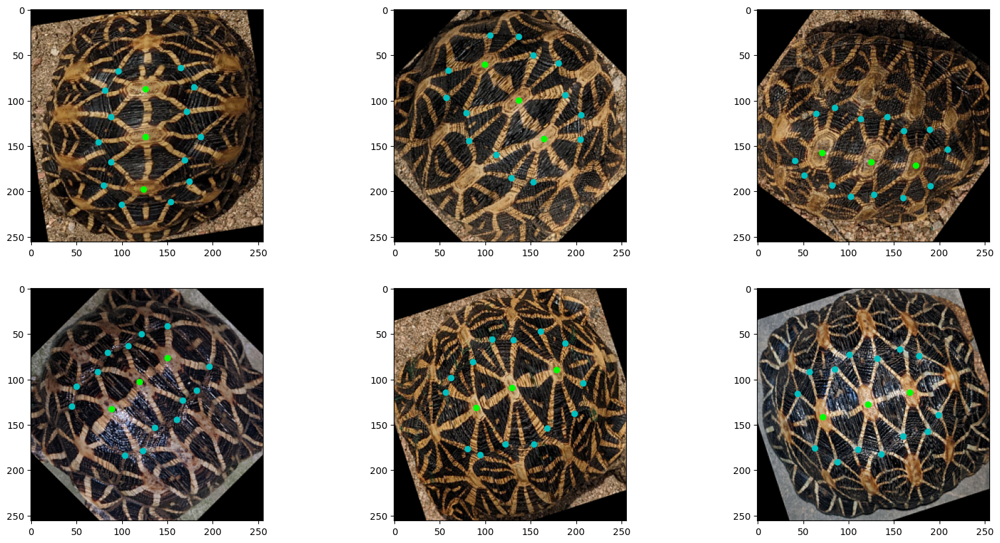

In [18]:
rotated_images, rotated_keypoints = rotate_images_keypoints(train_images, train_keypoints, np.arange(9, 360, 9))
print(rotated_images.shape)
print(rotated_keypoints.shape)
plot_images_keypoints(rotated_images, rotated_keypoints)

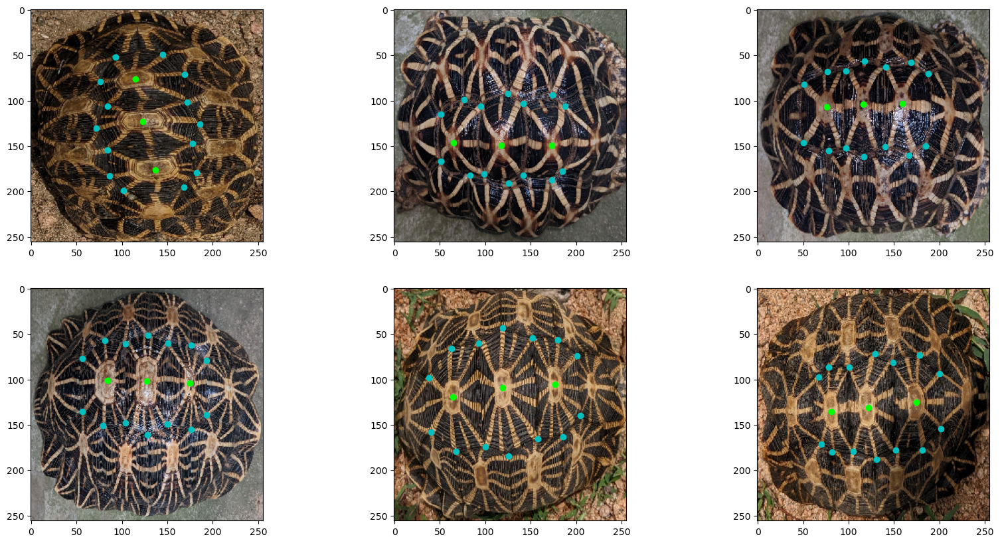

In [19]:
plot_images_keypoints(train_images, train_keypoints)

In [20]:
train_images = np.concatenate((train_images, rotated_images))
train_keypoints = np.concatenate((train_keypoints, rotated_keypoints))

In [21]:
print(train_images.shape)
print(train_keypoints.shape)

(6480, 256, 256, 3)
(6480, 34)


## Shift

In [26]:
def shift_images(images, keypoints, image_size, pixels=[12]):
    shifted_images = []
    shifted_keypoints = []
    for shift in pixels:    # Augmenting over several pixel shift values
        for (shift_x,shift_y) in [(-shift,-shift),(-shift,shift),(shift,-shift),(shift,shift)]:
            M = np.float32([[1,0,shift_x],[0,1,shift_y]])
            for image, keypoint in zip(images, keypoints):
                shifted_image = cv2.warpAffine(image, M, (image_size,image_size), flags=cv2.INTER_CUBIC)
                shifted_keypoint = np.array([(point+shift_x) if idx%2==0 else (point+shift_y) for idx, point in enumerate(keypoint)])
                if np.all(0.0<shifted_keypoint) and np.all(shifted_keypoint<image_size):
                    shifted_images.append(shifted_image.reshape(image_size, image_size, 3))
                    shifted_keypoints.append(shifted_keypoint)
    shifted_keypoints = np.clip(shifted_keypoints,0.0,image_size)
    return shifted_images, shifted_keypoints

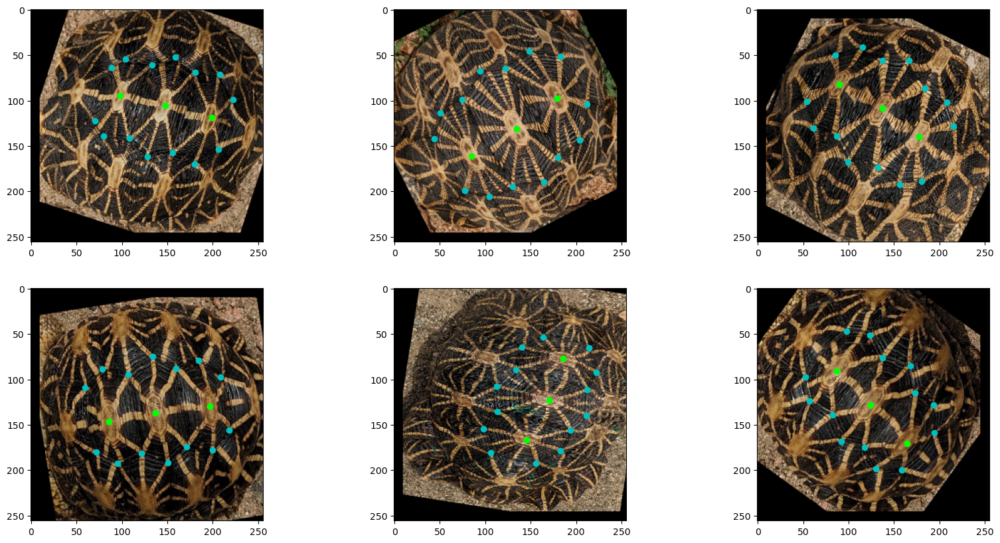

In [27]:
shifted_train_images, shifted_train_keypoints = shift_images(train_images, train_keypoints, IMAGE_SIZE, pixels=[10])
plot_images_keypoints(shifted_train_images, shifted_train_keypoints)

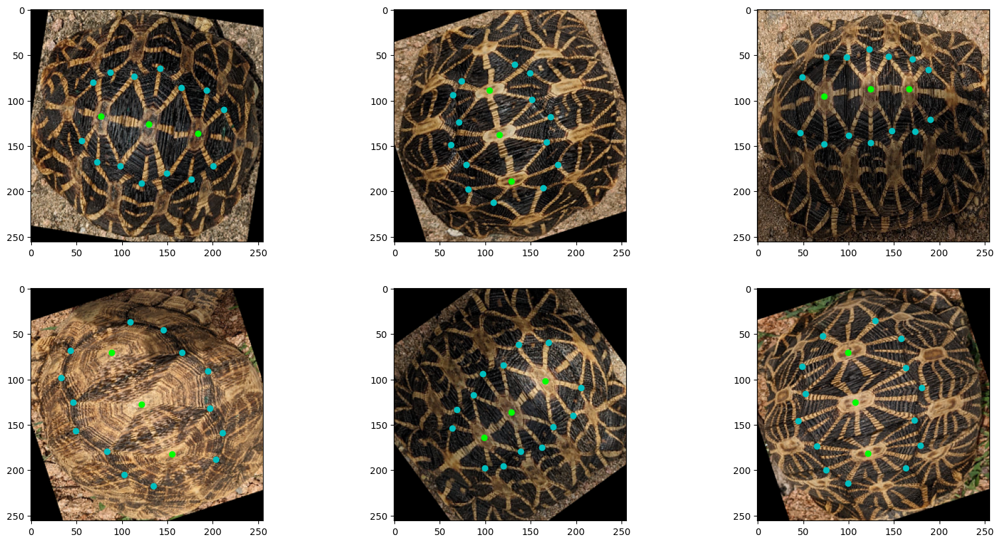

In [28]:
plot_images_keypoints(train_images, train_keypoints)

In [29]:
train_images = np.concatenate((train_images, shifted_train_images))
train_keypoints = np.concatenate((train_keypoints, shifted_train_keypoints))

In [11]:
print(train_images.shape)
print(train_keypoints.shape)

(51, 256, 256, 3)
(51, 34)


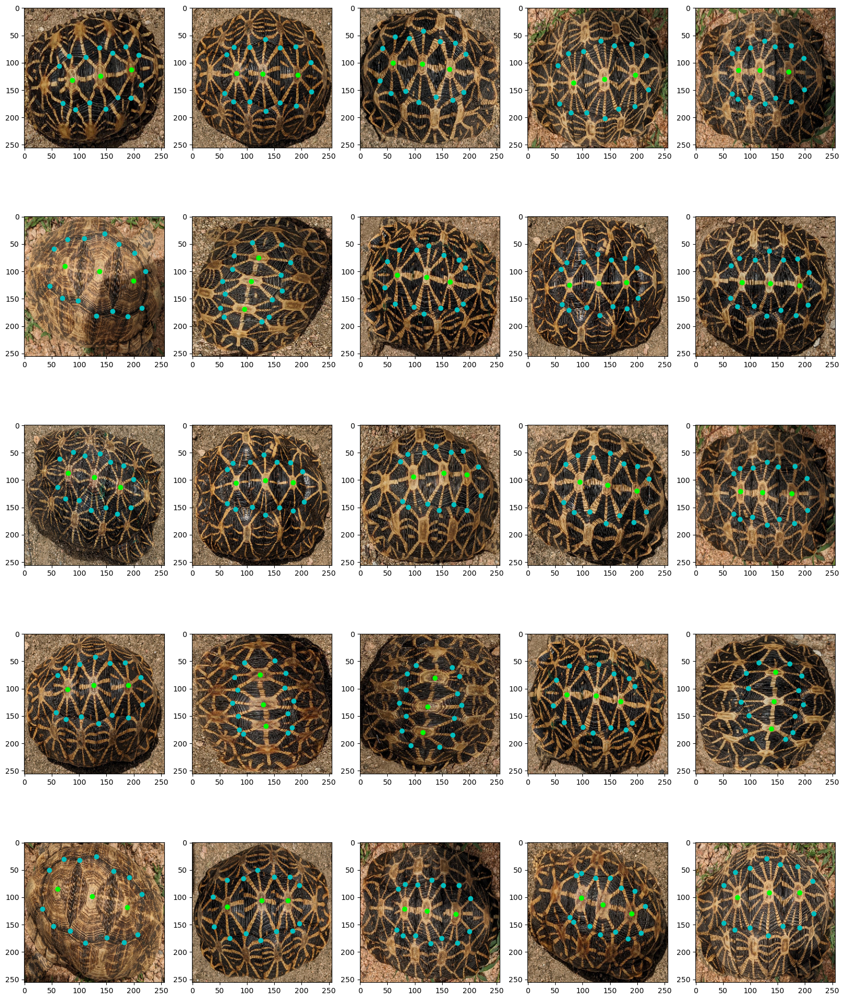

In [12]:
plot_images_keypoints(train_images, train_keypoints, rows=5, cols=5)

In [1175]:
np.rint(((len(image_names) * 2**exponent) / BATCH_SIZE)*0.2)

4.0

In [1248]:
IMAGE_SIZE = 224 # 256
BATCH_SIZE = 16
VAL_SPLIT = 0.25

autotune = tf.data.AUTOTUNE
raw_dataset = tf.data.TFRecordDataset(records)
parsed_dataset = raw_dataset.map(parse_tfrecord_fn, num_parallel_calls=autotune)
train_dataset = parsed_dataset.map(lambda x, y: resize_images_keypoints(x, y, IMAGE_SIZE), num_parallel_calls=autotune)

train_dataset, val_dataset = tf.keras.utils.split_dataset(train_dataset, right_size=VAL_SPLIT)

#  Multiply dataset by 2^n.
exponent = 8
for i in range(exponent):
    train_dataset = train_dataset.concatenate(train_dataset)
    val_dataset = val_dataset.concatenate(val_dataset)

train_dataset = train_dataset.map(flip_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.map(rotate_images_keypoints, num_parallel_calls=autotune)
train_dataset = train_dataset.shuffle(8*BATCH_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)
train_dataset = train_dataset.prefetch(autotune)

val_dataset = val_dataset.map(flip_images_keypoints, num_parallel_calls=autotune)
val_dataset = val_dataset.map(rotate_images_keypoints, num_parallel_calls=autotune)
val_dataset = val_dataset.shuffle(8*BATCH_SIZE)
val_dataset = val_dataset.batch(BATCH_SIZE)
val_dataset = val_dataset.prefetch(autotune)

# Model

In [1249]:
base_model = keras.applications.EfficientNetV2B0(
    include_top=False, pooling='avg', weights='imagenet',
    )

In [1250]:
# Want the last layer to be dense layer with 34 nodes
inputs = keras.Input(shape=(IMAGE_SIZE, IMAGE_SIZE, 3))
x = base_model(inputs, training=True)
x = keras.layers.Dropout(0.1)(x)
outputs = keras.layers.Dense(34)(x)
model = keras.Model(inputs, outputs)

model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
    loss='mean_squared_error',
    metrics=['acc'],
    )
model.summary()

Model: "model_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_32 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 efficientnetv2-b0 (Function  (None, 1280)             5919312   
 al)                                                             
                                                                 
 dropout_14 (Dropout)        (None, 1280)              0         
                                                                 
 dense_14 (Dense)            (None, 34)                43554     
                                                                 
Total params: 5,962,866
Trainable params: 5,902,258
Non-trainable params: 60,608
_________________________________________________________________


In [1251]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

# Define callbacks

# Early stopping if no improvement
early_stop = EarlyStopping(monitor = 'val_loss', 
                           patience = 32,
                           mode = 'min',
                           baseline=None,
                           restore_best_weights=True)

# Reduce learning rate when a metric has stopped improving.
reduce_lr = ReduceLROnPlateau(monitor = 'val_loss', 
                              factor = 0.5,
                              patience = 16,
                              min_lr = 1e-15,
                              mode = 'min', 
                              verbose = 1)

callbacks_list = [early_stop, reduce_lr]

In [1252]:
history=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=callbacks_list
                )

Epoch 1/1000


2022-11-01 09:00:45.482041: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


976/976 [==============================] - ETA: 0s - loss: 2520.3379 - acc: 0.0899

2022-11-01 09:03:23.565922: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


976/976 [==============================] - 183s 170ms/step - loss: 2520.3379 - acc: 0.0899 - val_loss: 1231.9921 - val_acc: 0.2338 - lr: 0.0010
Epoch 2/1000
976/976 [==============================] - 153s 157ms/step - loss: 670.1242 - acc: 0.4015 - val_loss: 544.6564 - val_acc: 0.4148 - lr: 0.0010
Epoch 3/1000
976/976 [==============================] - 155s 159ms/step - loss: 246.1882 - acc: 0.5447 - val_loss: 478.1791 - val_acc: 0.5422 - lr: 0.0010
Epoch 4/1000
976/976 [==============================] - 154s 158ms/step - loss: 184.4028 - acc: 0.6537 - val_loss: 559.8981 - val_acc: 0.5572 - lr: 0.0010
Epoch 5/1000
976/976 [==============================] - 155s 158ms/step - loss: 141.9814 - acc: 0.7323 - val_loss: 514.2111 - val_acc: 0.6227 - lr: 0.0010
Epoch 6/1000
976/976 [==============================] - 154s 158ms/step - loss: 125.9431 - acc: 0.7602 - val_loss: 408.8369 - val_acc: 0.6494 - lr: 0.0010
Epoch 7/1000
976/976 [==============================] - 154s 157ms/step - loss: 1

In [ ]:
history=model.fit(train_dataset,
                  epochs=1000,
                  validation_data=val_dataset,
                  callbacks=callbacks_list
                )

Epoch 1/1000


2022-10-31 22:42:24.955010: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


976/976 [==============================] - ETA: 0s - loss: 3900.7134 - acc: 0.0756

2022-10-31 22:45:23.579458: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


976/976 [==============================] - 207s 196ms/step - loss: 3900.7134 - acc: 0.0756 - val_loss: 2089.6953 - val_acc: 0.1629 - lr: 0.0010
Epoch 2/1000
976/976 [==============================] - 180s 184ms/step - loss: 1056.2379 - acc: 0.3715 - val_loss: 873.5630 - val_acc: 0.3922 - lr: 0.0010
Epoch 3/1000
976/976 [==============================] - 179s 184ms/step - loss: 366.6679 - acc: 0.5058 - val_loss: 742.2230 - val_acc: 0.4297 - lr: 0.0010
Epoch 4/1000
976/976 [==============================] - 180s 183ms/step - loss: 251.4243 - acc: 0.6347 - val_loss: 654.5069 - val_acc: 0.5637 - lr: 0.0010
Epoch 5/1000
976/976 [==============================] - 185s 189ms/step - loss: 184.0305 - acc: 0.7212 - val_loss: 602.1652 - val_acc: 0.5949 - lr: 0.0010
Epoch 6/1000
976/976 [==============================] - 187s 191ms/step - loss: 172.8758 - acc: 0.7430 - val_loss: 631.2602 - val_acc: 0.5943 - lr: 0.0010
Epoch 7/1000
976/976 [==============================] - 187s 191ms/step - loss: 

In [ ]:
BATCH_SIZE = 8
history=model.fit(x=train_images,
                  y=train_keypoints,
                  epochs=1000,
                  batch_size=BATCH_SIZE,
                  validation_split=1/4,
                  callbacks=[early_stop, reduce_lr]
                )

Epoch 1/500


2022-10-30 20:56:55.450263: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-10-30 20:56:59.659251: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1519/1519 [==============================] - ETA: 0s - loss: 3689.3979 - acc: 0.0438

2022-10-30 21:01:43.602749: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1519/1519 [==============================] - 324s 204ms/step - loss: 3689.3979 - acc: 0.0438 - val_loss: 3455.0122 - val_acc: 0.0412 - lr: 0.0010
Epoch 2/500
1519/1519 [==============================] - 340s 224ms/step - loss: 2325.5764 - acc: 0.0409 - val_loss: 2555.9824 - val_acc: 0.0190 - lr: 0.0010
Epoch 3/500
1519/1519 [==============================] - 341s 224ms/step - loss: 2236.5566 - acc: 0.0462 - val_loss: 2396.1943 - val_acc: 0.0259 - lr: 0.0010
Epoch 4/500
1519/1519 [==============================] - 344s 226ms/step - loss: 2230.7925 - acc: 0.0451 - val_loss: 2333.1985 - val_acc: 0.0606 - lr: 0.0010
Epoch 5/500
1519/1519 [==============================] - 340s 223ms/step - loss: 2229.4636 - acc: 0.0560 - val_loss: 2303.8623 - val_acc: 0.0456 - lr: 0.0010
Epoch 6/500
1519/1519 [==============================] - 340s 224ms/step - loss: 2229.3828 - acc: 0.0486 - val_loss: 2336.1333 - val_acc: 0.0230 - lr: 0.0010
Epoch 7/500
1519/1519 [==============================] - 338s 22

KeyboardInterrupt: 

2/2 [==============================] - 1s 545ms/step


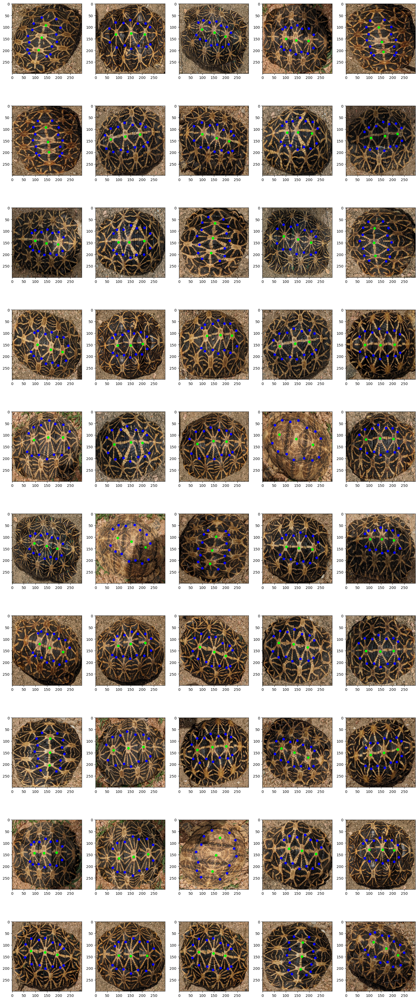

In [ ]:
pred = model.predict(resized_imgs)

plot_images_landmarks(resized_imgs, pred, rows=10, cols=5)

In [ ]:
import joblib
joblib.dump(model, "model.joblib")

INFO:tensorflow:Assets written to: ram://5697c8bd-eafa-4613-ad58-5750f73b9d66/assets


INFO:tensorflow:Assets written to: ram://5697c8bd-eafa-4613-ad58-5750f73b9d66/assets


['model.joblib']

In [ ]:
model.save('loss=23/model.h5')

2022-10-03 12:05:42.959234: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


2/2 [==============================] - 3s 1s/step


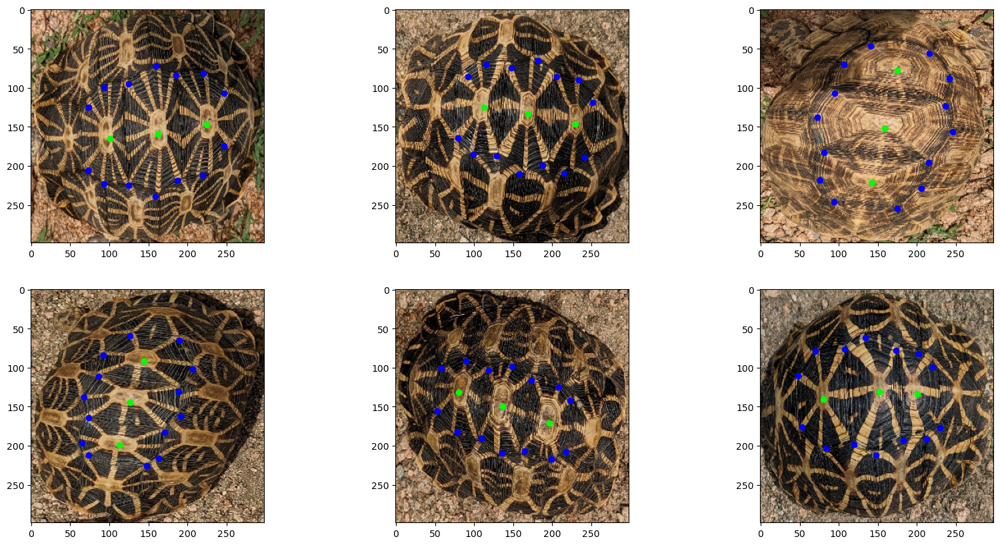

In [101]:
moot = joblib.load("loss=23/model.joblib")

pred = moot.predict(resized_imgs)
plot_images_landmarks(resized_imgs, pred)